# DSCI 100-004: Group 19 Proposal

Aadeesh Nargotra, Hongwei Wang, Joshua Tan, Nayeon Lee

## Introduction

### Background and Significance

 regularly receive feedback from customers who utilize their planes based on their experience. A major responsibility of airlines when it comes to providing amenities is to ensure that customers have the best possible experience while flying. By identifying areas for improvement, airlines would be able to better understand customer needs, thereby increasing customer retention. We will be answering our predictive question, “can we predict the next customer’s satisfaction as satisfied or dissatisfied based on the airplane satisfaction data?”  The factors that can determine our classification include, departure/arrival delays, gate location, online boarding, inflight entertainment, legroom service, check-in service, inflight wifi service, food and drink, seat comfort, on-board service baggage handling, and cleanliness. We will be utilizing ‘Airline Passenger Satisfaction’ dataset by T.J. Klein on Kagle. https://www.kaggle.com/datasets/teejmahal20/airline-passenger-satisfaction/data


## Preliminary Exploratory Data Analysis

### Reading the Aiplane Dataset

In [5]:
library(tidyverse)
install.packages("janitor")
library(janitor)
library(tidymodels)
install.packages("gridExtra")
library(gridExtra)

also installing the dependency ‘snakecase’


Updating HTML index of packages in '.Library'

Making 'packages.html' ...
 done


Attaching package: ‘janitor’


The following objects are masked from ‘package:stats’:

    chisq.test, fisher.test


── Attaching packages ────────────────────────────────────── tidymodels 1.0.0 ──

✔ broom        1.0.2     ✔ rsample      1.1.1
✔ dials        1.1.0     ✔ tune         1.0.1
✔ infer        1.0.4     ✔ workflows    1.1.2
✔ modeldata    1.0.1     ✔ workflowsets 1.0.0
✔ parsnip      1.0.3     ✔ yardstick    1.1.0
✔ recipes      1.0.4     

── Conflicts ───────────────────────────────────────── tidymodels_conflicts() ──
✖ scales::discard() masks purrr::discard()
✖ dplyr::filter()   masks stats::filter()
✖ recipes::fixed()  masks stringr::fixed()
✖ dplyr::lag()      masks stats::lag()
✖ yardstick::spec() masks readr::spec()
✖ recipes::step()   masks stats::step()
• Search for functions across packages at https://www.tidymodels.org/find/

Updating HTML

In [2]:
# Reading downloaded training and test datasets from Kaggle

test_set <- read_csv("test.csv") 
train_set <- read_csv("train.csv")

New names:
• `` -> `...1`
Rows: 25976 Columns: 25
── Column specification ────────────────────────────────────────────────────────
Delimiter: ","
chr  (5): Gender, Customer Type, Type of Travel, Class, satisfaction
dbl (20): ...1, id, Age, Flight Distance, Inflight wifi service, Departure/A...

ℹ Use `spec()` to retrieve the full column specification for this data.
ℹ Specify the column types or set `show_col_types = FALSE` to quiet this message.
New names:
• `` -> `...1`
Rows: 103904 Columns: 25
── Column specification ────────────────────────────────────────────────────────
Delimiter: ","
chr  (5): Gender, Customer Type, Type of Travel, Class, satisfaction
dbl (20): ...1, id, Age, Flight Distance, Inflight wifi service, Departure/A...

ℹ Use `spec()` to retrieve the full column specification for this data.
ℹ Specify the column types or set `show_col_types = FALSE` to quiet this message.


### Cleaning the Airplane Dataset

In [7]:
# Combining test and training datasets (we will split it ourselves)

airplane_data <- rbind(test_set, train_set)

# Creating clean names for the variables (i.e., snake_case)

airplane_data <- clean_names(airplane_data)

# Converting the character class 'satisfaction' variable to the factor datatype

airplane_data <- airplane_data |> mutate(satisfaction = as_factor(satisfaction))

# Remove the x1 column

airplane_data <- airplane_data |> select(2:25)
                
# Checking if there are any NA's 

map_df(airplane_data, ~sum(is.na(.)))  # There are 393 NA's in arrival_delay_in_minutes

# Removing the NA's because there aren't that many 

airplane_data_cleaned <- airplane_data |> drop_na()

# tibble(sum(is.na(airplane_data_cleaned))) # Number of Total NA's is now 0



id,gender,customer_type,age,type_of_travel,class,flight_distance,inflight_wifi_service,departure_arrival_time_convenient,ease_of_online_booking,⋯,inflight_entertainment,on_board_service,leg_room_service,baggage_handling,checkin_service,inflight_service,cleanliness,departure_delay_in_minutes,arrival_delay_in_minutes,satisfaction
<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>,⋯,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>
0,0,0,0,0,0,0,0,0,0,⋯,0,0,0,0,0,0,0,0,393,0


### Splitting: airplane_data_cleaned

In [8]:
set.seed(1234)

airplane_split <- initial_split(airplane_data_cleaned, prop = 0.75, strata = satisfaction)

airplane_train <- training(airplane_split)
airplane_test <- testing(airplane_split)

### satisfaction Proportions for Test, Training, and Overall Data

In [9]:
# Checking that the proportions for our training and test set are similar to our overall cleaned dataset

airplane_train_proportions <- airplane_train |>
                            group_by(satisfaction) |>
                            summarize(n = n()) |>
                            mutate(percent = 100*n/nrow(airplane_train))

airplane_train_proportions

airplane_test_proportions <- airplane_test |>
                            group_by(satisfaction) |>
                            summarize(n = n()) |>
                            mutate(percent = 100*n/nrow(airplane_test))

airplane_test_proportions

airplane_data_cleaned_proportions <- airplane_data_cleaned |>
                            group_by(satisfaction) |>
                            summarize(n = n()) |>
                            mutate(percent = 100*n/nrow(airplane_data_cleaned))

airplane_data_cleaned_proportions

satisfaction,n,percent
<fct>,<int>,<dbl>
satisfied,42196,43.44997
neutral or dissatisfied,54918,56.55003


satisfaction,n,percent
<fct>,<int>,<dbl>
satisfied,14066,43.44979
neutral or dissatisfied,18307,56.55021


satisfaction,n,percent
<fct>,<int>,<dbl>
satisfied,56262,43.44992
neutral or dissatisfied,73225,56.55008


### Summarizing Airplane Data in Tables

In [10]:
# The means of potential predictor variables that are numerical datatype only 

airplane_means_total <- airplane_train |>
    select(7:23) |>
    map_df(mean)

airplane_means_total

# The means of potential predictor variables, grouped by satisfaction that are numerical datatype only 

airplane_means_grouped <- airplane_train |>
    group_by(satisfaction) |>
    summarize(across(flight_distance:arrival_delay_in_minutes, mean))

airplane_means_grouped

flight_distance,inflight_wifi_service,departure_arrival_time_convenient,ease_of_online_booking,gate_location,food_and_drink,online_boarding,seat_comfort,inflight_entertainment,on_board_service,leg_room_service,baggage_handling,checkin_service,inflight_service,cleanliness,departure_delay_in_minutes,arrival_delay_in_minutes
<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
1192.505,2.728134,3.053916,2.754701,2.976533,3.207982,3.252394,3.442593,3.357724,3.380285,3.349744,3.6289,3.303962,3.640248,3.28793,14.61467,15.08051


satisfaction,flight_distance,inflight_wifi_service,departure_arrival_time_convenient,ease_of_online_booking,gate_location,food_and_drink,online_boarding,seat_comfort,inflight_entertainment,on_board_service,leg_room_service,baggage_handling,checkin_service,inflight_service,cleanliness,departure_delay_in_minutes,arrival_delay_in_minutes
<fct>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
satisfied,1531.9291,3.156460,2.957603,3.024718,2.970068,3.528107,4.025950,3.967793,3.963954,3.852877,3.820338,3.967130,3.646933,3.97296,3.747867,12.44085,12.55948
neutral or dissatisfied,931.7104,2.399031,3.127918,2.547234,2.981500,2.962016,2.658036,3.039058,2.891930,3.017171,2.988164,3.369023,3.040442,3.38461,2.934539,16.28492,17.01754


### Visualizing Airplane Training Data in Plots

In [19]:
options(repr.plot.width = 15, repr.plot.height = 8)

plot_wifi <- airplane_train |>
        ggplot(aes(x = inflight_wifi_service, fill = satisfaction)) +
                geom_bar(stat = "count", position = "dodge") +
        labs(x = "Inflight Wifi Service", y = "Count")

plot_departure_arrival <- airplane_train |>
        ggplot(aes(x = departure_arrival_time_convenient, fill = satisfaction)) +
                geom_bar(stat = "count", position = "dodge") +
        labs(x = "Conveniency of Departure/Arrival Time", y = "Count")

plot_online_booking <- airplane_train |>
        ggplot(aes(x = ease_of_online_booking, fill = satisfaction)) +
                geom_bar(stat = "count", position = "dodge") +
        labs(x = "Ease of Online Booking", y = "Count")

plot_gate_location <- airplane_train |>
        ggplot(aes(x = gate_location, fill = satisfaction)) +
                geom_bar(stat = "count", position = "dodge") +
        labs(x = "Gate Location", y = "Count")

plot_food_and_drink <- airplane_train |>
        ggplot(aes(x = food_and_drink, fill = satisfaction)) +
                geom_bar(stat = "count", position = "dodge") +
        labs(x = "Food and Drink", y = "Count")

plot_online_boarding <- airplane_train |>
        ggplot(aes(x = online_boarding, fill = satisfaction)) +
                geom_bar(stat = "count", position = "dodge") +
        labs(x = "Online Boarding", y = "Count")

plot_seat_comfort <- airplane_train |>
        ggplot(aes(x = seat_comfort, fill = satisfaction)) +
                geom_bar(stat = "count", position = "dodge") +
        labs(x = "Seat Comfort", y = "Count")

plot_entertainment <- airplane_train |>
        ggplot(aes(x = inflight_entertainment, fill = satisfaction)) +
                geom_bar(stat = "count", position = "dodge") +
        labs(x = "Inflight Entertainment", y = "Count")

plot_onboard_service <- airplane_train |>
        ggplot(aes(x = on_board_service, fill = satisfaction)) +
                geom_bar(stat = "count", position = "dodge") +
        labs(x = "On-Board Service", y = "Count")

plot_leg_room_service <- airplane_train |>
        ggplot(aes(x = leg_room_service, fill = satisfaction)) +
                geom_bar(stat = "count", position = "dodge") +
        labs(x = "Leg Room Service", y = "Count")

plot_baggage_handling <- airplane_train |>
        ggplot(aes(x = baggage_handling, fill = satisfaction)) +
                geom_bar(stat = "count", position = "dodge") +
        labs(x = "Baggage Handling", y = "Count")

plot_checkin_service <- airplane_train |>
        ggplot(aes(x = checkin_service, fill = satisfaction)) +
                geom_bar(stat = "count", position = "dodge") +
        labs(x = "Check-In Service", y = "Count")

plot_cleanliness <- airplane_train |>
        ggplot(aes(x = cleanliness, fill = satisfaction)) +
                geom_bar(stat = "count", position = "dodge") +
        labs(x = "Cleanliness", y = "Count")


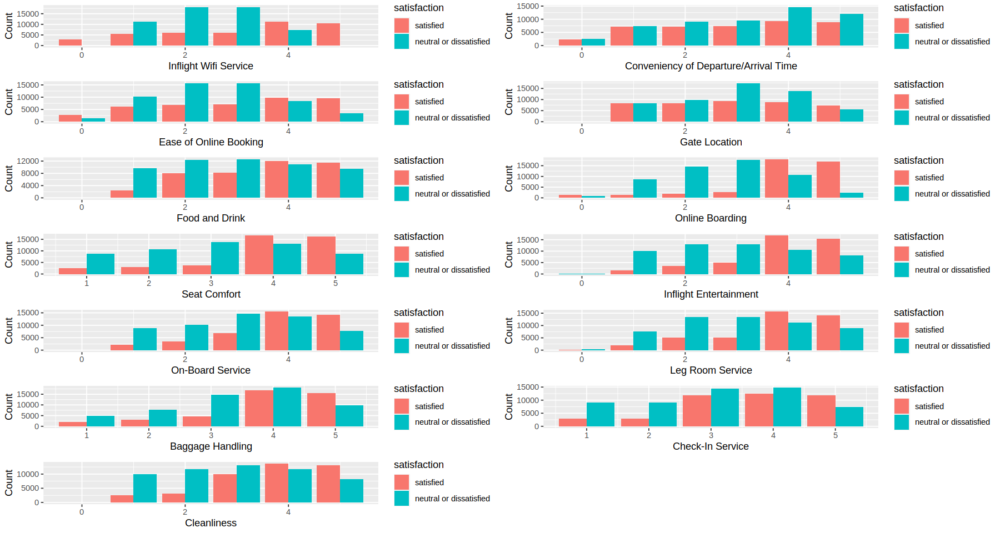

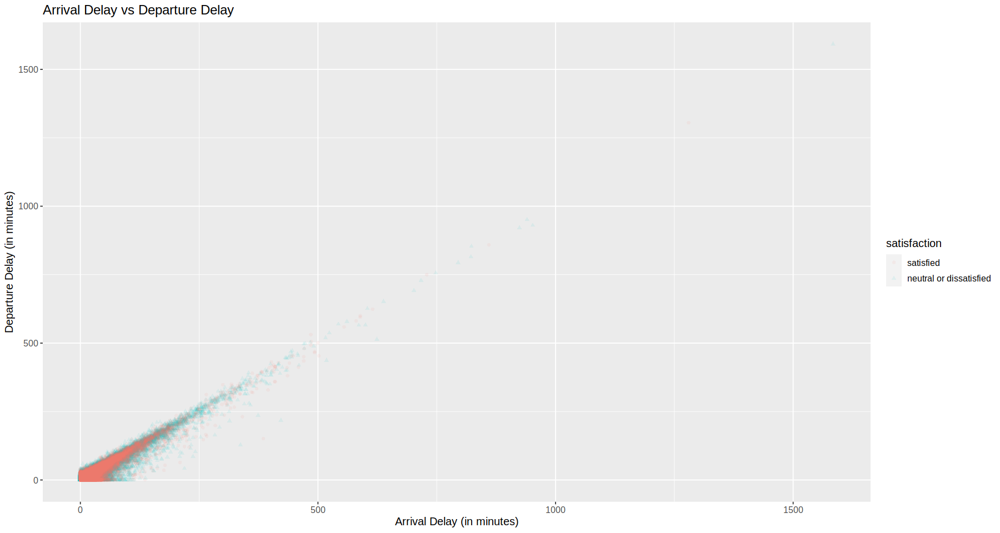

In [22]:
all_plots <- grid.arrange(plot_wifi, plot_departure_arrival, plot_online_booking, plot_gate_location, 
                        plot_food_and_drink, plot_online_boarding, plot_seat_comfort, plot_entertainment,
                        plot_onboard_service, plot_leg_room_service, plot_baggage_handling, plot_checkin_service,
                        plot_cleanliness, ncol = 2)

arrival_departure_delay_plot <- airplane_train |>
                            ggplot(aes(x = arrival_delay_in_minutes, y = departure_delay_in_minutes, color = satisfaction, shape = satisfaction)) +
                            geom_point(alpha = 0.08) + 
                            theme(text = element_text(size = 12)) +
                            labs(x = "Arrival Delay (in minutes)", y = "Departure Delay (in minutes)") + 
                            ggtitle("Arrival Delay vs Departure Delay")

arrival_departure_delay_plot
           

## Methods

Based on the data analysis will be done through a varying process of graphs. It appears that the analysis is focused on visualizing various factors affecting the satisfaction of airline passengers. The data includes different variables related to airplane services, and the visualizations aim to show the relationship between these variables and passenger satisfaction.
For a more accurate prediction, we focus on columns that potentially have a strong correlation with passenger satisfaction. Here's a brief outline: Numerical Variables: flight_distance, arrival_delay_in_minutes, and departure_delay_in_minutes.
These variables were chosen based on information from the internet and the use of graphical displays we created within R: The distance and delay of a flight can significantly affect passenger satisfaction.

- Categorical Variables: The dataset has various ratings (from 0 to 5) for different services such as inflight_wifi_service, seat_comfort, on_board_service, leg_room_service, etc. These ratings reflect passenger experience and should be highly predictive of overall satisfaction. Some columns might be correlated with others or might not have a strong impact on satisfaction. For instance, gate_location might not have as strong an impact on satisfaction as seat_comfort or inflight_entertainment.

To determine passenger satisfaction, it's crucial to understand that one predictor cannot determine the overall satisfaction of a customer’s airline experience. In other words, one aspect of an airplane experience does not make or break their overall impression. This multifaceted nature of airline experiences implies that there might not be a single dominant factor that dictates a passenger's satisfaction, but rather a combination of various factors that collectively influence their perception.
For instance, while seat comfort is undeniably important for a pleasant flight experience, it alone cannot determine whether a passenger's overall flight experience was good or bad. It's entirely possible for a passenger to have a comfortable seat but still have a negative experience due to poor inflight service or a significant flight delay. Conversely, a passenger might tolerate a less-than-ideal seat if they receive exceptional service and other amenities. Thus, it's the cumulative effect of multiple factors that decide their satisfaction.

For visualizing the results, one effective approach is to use bar plots and scatter plots. This can depict the correlation between each of these variables and passenger satisfaction. High positive correlations indicate a variable is strongly linked to satisfaction, while negative correlations indicate the opposite. Neutral values show little to no impact on satisfaction. A scatter plot can show the correlation between delays and passenger satisfaction. A trend line can further emphasize any patterns. This visualization can quickly highlight the most significant variables influencing passenger satisfaction. 


## Expected Outcomes and Significance

Through analyzing this dataset, we anticipate being able to predict a customer’s satisfaction level based on variables such as arrival delay, departure delay and flight distance. The variables that we are specifically interested in include, inflight wifi service, seat comfort, on board service, leg room service. Adding on, the findings can provide airlines with actionable insights into the key factors influencing passenger satisfaction. This information can then be leveraged to improve customer experience. By understanding whether a passenger’s overall satisfaction level is satisfied or dissatisfied/neutral based on our predictor variables, an airline could potentially improve its services. For example, an airline could reduce their arrival and departure delays, thereby increasing potential customers to choose that specific airline over another. Our findings can lead to various questions such as, to what degree do external factors (such as weather, traffic, etc.) affect these indicators and the overall satisfaction? Are there any noticeable trends in customer satisfaction (ie. are they more amiable towards the holiday season and hostile towards earning break)? How much can they compromise on one variable without largely affecting their approval ratings?
